# World Bank Indicators - GDP per capita from 1960 to 2018

<hr>

GDP per capita is gross domestic product divided by midyear population. GDP is the sum of gross value added by all resident producers in the economy plus any product taxes and minus any subsidies not included in the value of the products. It is calculated without making deductions for depreciation of fabricated assets or for depletion and degradation of natural resources. Data are in current U.S. dollars.

## Import required libraries

In [96]:
import pandas as pd
import datetime
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML

## Data pre-processing

In [97]:
df = pd.read_csv("Data/World_Development_Indicators.csv", usecols=["Time", "Country Name", "GDP per capita (current US$) [NY.GDP.PCAP.CD]"])

df.rename(columns={"Time": "Year", "Country Name": "Country", "GDP per capita (current US$) [NY.GDP.PCAP.CD]": "GDP_capita"}, inplace=True)

df.replace('..', np.nan, inplace=True) 
df.dropna(inplace=True)
df["GDP_capita"] = df["GDP_capita"].astype(float)
df["Year"] = pd.DatetimeIndex(df["Year"])
df.set_index("Year", inplace=True)
df.head()

,Country,GDP_capita
Year,,
1960-01-01,Afghanistan,59.773194
1960-01-01,Algeria,246.308763
1960-01-01,Australia,1807.785710
1960-01-01,Austria,935.460427
1960-01-01,"Bahamas, The",1550.239392


In [98]:
resampled_data = df.groupby('Country').resample('Q').mean()
resampled_data['GDP_capita'] = resampled_data['GDP_capita'].interpolate()
resampled_data

GDP_capita
Country     Year                   
Afghanistan 1960-03-31    59.773194
            1960-06-30    59.795114
            1960-09-30    59.817034
            1960-12-31    59.838954
            1961-03-31    59.860874
...                             ...
Zimbabwe    2017-03-31  1602.403507
            2017-06-30  1738.551726
            2017-09-30  1874.699946
            2017-12-31  2010.848165
            2018-03-31  2146.996385

[38468 rows x 1 columns]

In [99]:
resampled_data.reset_index(inplace = True)
resampled_data.sort_values(["Year", "Country"], axis = 0, ascending = True, inplace = True) 
resampled_data.reset_index(inplace=True, drop=True) 
resampled_data = resampled_data[["Year", "Country", "GDP_capita"]]
resampled_data

,Year,Country,GDP_capita
0,1960-03-31,Afghanistan,59.773194
1,1960-03-31,Algeria,246.308763
2,1960-03-31,Australia,1807.785710
3,1960-03-31,Austria,935.460427
4,1960-03-31,"Bahamas, The",1550.239392
...,...,...,...
38463,2018-03-31,Vietnam,2566.596950
38464,2018-03-31,West Bank and Gaza,3198.866644
38465,2018-03-31,"Yemen, Rep.",944.408499
38466,2018-03-31,Zambia,1539.900158


In [100]:
frames_list = resampled_data["Year"].unique()
frames_list

array(['1960-03-31T00:00:00.000000000', '1960-06-30T00:00:00.000000000',
       '1960-09-30T00:00:00.000000000', '1960-12-31T00:00:00.000000000',
       '1961-03-31T00:00:00.000000000', '1961-06-30T00:00:00.000000000',
       '1961-09-30T00:00:00.000000000', '1961-12-31T00:00:00.000000000',
       '1962-03-31T00:00:00.000000000', '1962-06-30T00:00:00.000000000',
       '1962-09-30T00:00:00.000000000', '1962-12-31T00:00:00.000000000',
       '1963-03-31T00:00:00.000000000', '1963-06-30T00:00:00.000000000',
       '1963-09-30T00:00:00.000000000', '1963-12-31T00:00:00.000000000',
       '1964-03-31T00:00:00.000000000', '1964-06-30T00:00:00.000000000',
       '1964-09-30T00:00:00.000000000', '1964-12-31T00:00:00.000000000',
       '1965-03-31T00:00:00.000000000', '1965-06-30T00:00:00.000000000',
       '1965-09-30T00:00:00.000000000', '1965-12-31T00:00:00.000000000',
       '1966-03-31T00:00:00.000000000', '1966-06-30T00:00:00.000000000',
       '1966-09-30T00:00:00.000000000', '1966-12-31

## Color

In [101]:
country_df = df["Country"].unique()
nb_colors = len(country_df)

#cmap = plt.get_cmap('viridis')
#colors = [cmap(i) for i in range(nb_colors)]

colors = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(nb_colors)]

colors_dict = dict(zip(country_df, colors))
colors_dict

{'Afghanistan': '#B49515',
 'Algeria': '#AD251C',
 'Australia': '#12F750',
 'Austria': '#A2871E',
 'Bahamas, The': '#D2E855',
 'Bangladesh': '#2CAFE7',
 'Belgium': '#646427',
 'Belize': '#D3B6DF',
 'Benin': '#ACD4FA',
 'Bermuda': '#7268C7',
 'Bolivia': '#A4BFCA',
 'Botswana': '#8473DF',
 'Brazil': '#10867C',
 'Burkina Faso': '#76F385',
 'Burundi': '#DF4CE0',
 'Cambodia': '#D8E590',
 'Cameroon': '#E6C966',
 'Canada': '#89944C',
 'Central African Republic': '#D7300C',
 'Chad': '#7F9149',
 'Chile': '#626757',
 'China': '#B0033B',
 'Colombia': '#2608EB',
 'Congo, Dem. Rep.': '#EB6E1E',
 'Congo, Rep.': '#BD33B7',
 'Costa Rica': '#6E4212',
 "Cote d'Ivoire": '#F5A513',
 'Dominican Republic': '#F0F8DB',
 'Ecuador': '#32B355',
 'Eswatini': '#717973',
 'Fiji': '#956913',
 'Finland': '#A5F9AD',
 'France': '#B80AF8',
 'Gabon': '#C594C8',
 'Ghana': '#CFAEFC',
 'Greece': '#287FAF',
 'Guatemala': '#F2FA53',
 'Guyana': '#78D2B5',
 'Haiti': '#42AF87',
 'Honduras': '#A9B915',
 'Hong Kong SAR, China': '#

## Barchart

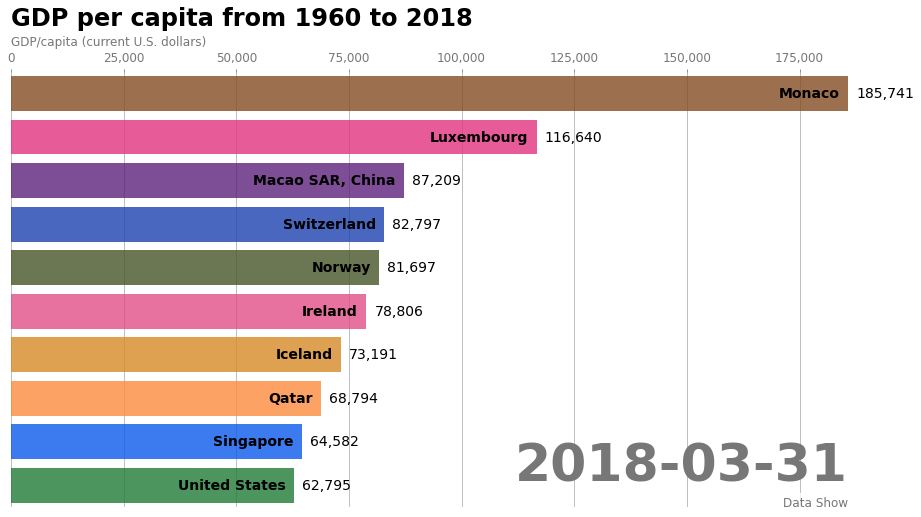

In [102]:
fig, ax = plt.subplots(figsize=(15, 8))

def draw_barchart(date):
    year_plot_df = resampled_data[monthly_resampled_data['Year'].eq(date)].sort_values(by='GDP_capita', ascending=True).tail(10)
    ax.clear()
    
    ax.barh(year_plot_df['Country'], year_plot_df['GDP_capita'], color=[colors_dict[i] for i in year_plot_df['Country']], alpha=0.8)
    
    dx = year_plot_df['GDP_capita'].max() / 100
    
    for i, (GDP, Country) in enumerate(zip(year_plot_df['GDP_capita'], year_plot_df['Country'])):
        ax.text(GDP-dx, i,     Country,           size=14, weight=600, ha='right', va='center')
        ax.text(GDP+dx, i,     f'{GDP:,.0f}',  size=14, ha='left',  va='center')
    
    ax.text(1, 0.06, date, transform=ax.transAxes, color='#777777', size=52, ha='right', weight=800)
    ax.text(0, 1.06, 'GDP/capita (current U.S. dollars)', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.15, 'GDP per capita from 1960 to 2018',
            transform=ax.transAxes, size=24, weight=600, ha='left', va='top')
    ax.text(1, 0, 'Data Show', transform=ax.transAxes, color='#777777', ha='right', size=12,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))
    plt.box(False)
    
draw_barchart('2018-03-31')

## Animation

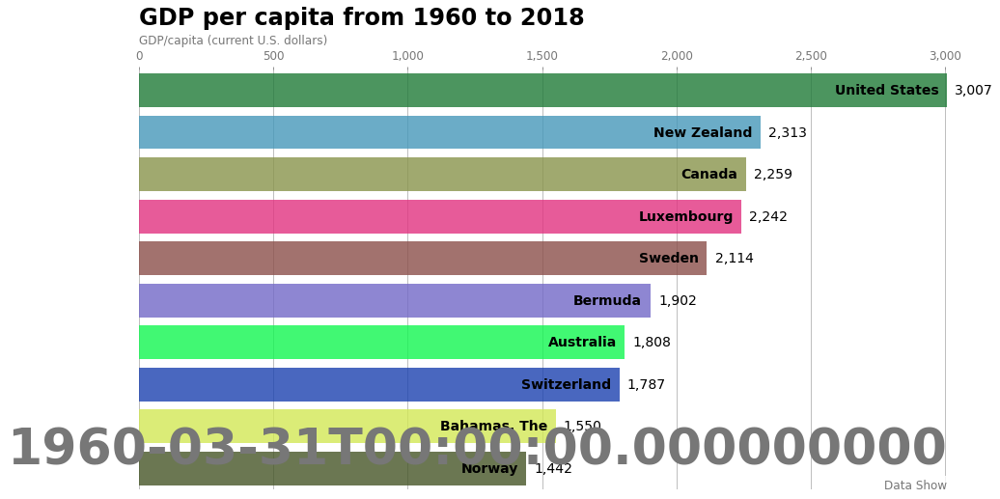

In [103]:
animation.rcParams['animation.embed_limit'] = 2**128

fig, ax = plt.subplots(figsize=(15, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=frames_list)
HTML(animator.to_jshtml())

<hr>

## Sources :

https://databank.worldbank.org/reports.aspx?source=2&series=NY.GDP.PCAP.CD&country=#